# Final Project
*By M. Nolan Gray*

For the midterm, I got a general sense for housing affordability and vehicular homelessness in Los Angeles, as well as the location of parking districts.

For this final project, I advance my research project in three main ways:
1. Normalize the vehicular homelessness data by population and run a spatial autocorrelation analysis to identify hotspots of each kind of vehicular homelessness.
2. Clean and join newly found 2016 Vehicular Homeless Count data and understand how vehicular homelessness has changed since the city first started tracking it.
3. Identify whether each tract contains an Overnight Parking District (OPD), which will be valuable for identifying relationships in subsequent research.

## 1. Spatial Statistics

### 1.1 Prepping the Data

As always, we start by importing libraries.

In [1]:
import pandas as pd
import geopandas as gpd
import contextily as ctx
import esda
from esda.moran import Moran, Moran_Local
import splot
from splot.esda import moran_scatterplot, plot_moran, lisa_cluster,plot_moran_simulation
import libpysal as lps
import matplotlib.pyplot as plt
import plotly.express as px
from pysal.lib import weights

'hdctla' is a geojson file containing vehicular homeless rates by census tract. I made it in a previous notebook. 'population' is a csv file containing the total population for each censust tract in LA—I need this to normalize the vehicular homelessness rates by population.

In [2]:
hdctla = gpd.read_file('output/hdctla.json')
population = gpd.read_file('Data/acs2019_5yr_B01003_14000US06037103400.csv')

In the next few code boxes, I'll be probing the files to see what I'm working with it.

In [3]:
hdctla.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 1004 entries, 0 to 1003
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   tract     1004 non-null   object  
 1   LA        1004 non-null   object  
 2   cars      1004 non-null   float64 
 3   vans      1004 non-null   float64 
 4   campers   1004 non-null   float64 
 5   total     1004 non-null   float64 
 6   geometry  1004 non-null   geometry
dtypes: float64(4), geometry(1), object(2)
memory usage: 55.0+ KB


In [4]:
population.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 1005 entries, 0 to 1004
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   geoid             1005 non-null   object  
 1   name              1005 non-null   object  
 2   B01003001         1005 non-null   object  
 3   B01003001, Error  1005 non-null   object  
 4   geometry          0 non-null      geometry
dtypes: geometry(1), object(4)
memory usage: 39.4+ KB


In [5]:
population.tail(5)

,geoid,name,B01003001,"B01003001, Error",geometry
1000,14000US06037980026,"Census Tract 9800.26, Los Angeles, CA",26,18,None
1001,14000US06037980028,"Census Tract 9800.28, Los Angeles, CA",0,12,None
1002,14000US06037980031,"Census Tract 9800.31, Los Angeles, CA",1175,178,None
1003,14000US06037990200,"Census Tract 9902, Los Angeles, CA",0,12,None
1004,16000US0644000,"Los Angeles, CA",3966936,82,None


Let's clean up the 'population' data.

In [6]:
population = population[['geoid','B01003001']]
population.columns = ['tract','TotalPop']
population = population.drop(1004)

In [7]:
population['tract'] = population['tract'].str[12:]

And now, let's merge them by tract ID.

In [8]:
merge = hdctla.merge(population,on='tract')

In [9]:
merge.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 1001 entries, 0 to 1000
Data columns (total 8 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   tract     1001 non-null   object  
 1   LA        1001 non-null   object  
 2   cars      1001 non-null   float64 
 3   vans      1001 non-null   float64 
 4   campers   1001 non-null   float64 
 5   total     1001 non-null   float64 
 6   geometry  1001 non-null   geometry
 7   TotalPop  1001 non-null   object  
dtypes: float64(4), geometry(1), object(3)
memory usage: 70.4+ KB


Hmm, only 1001 records matched out of 1004. Something I'll need to look into.

### 1.2 Normalizing Vehicular Homelessness by Population

Okay, let's normalize rates of vehicular homelessness.

In [10]:
merge['TotalPop'] = merge['TotalPop'].astype(float)

In [11]:
merge['total_per_1000'] = merge['total']/merge['TotalPop']*1000
merge['cars_per_1000'] = merge['cars']/merge['TotalPop']*1000
merge['vans_per_1000'] = merge['vans']/merge['TotalPop']*1000
merge['campers_per_1000'] = merge['campers']/merge['TotalPop']*1000

Let's identify the top 20 tracts for normalized vehicular homelessness.

In [12]:
merge = merge.to_crs(epsg=3857)

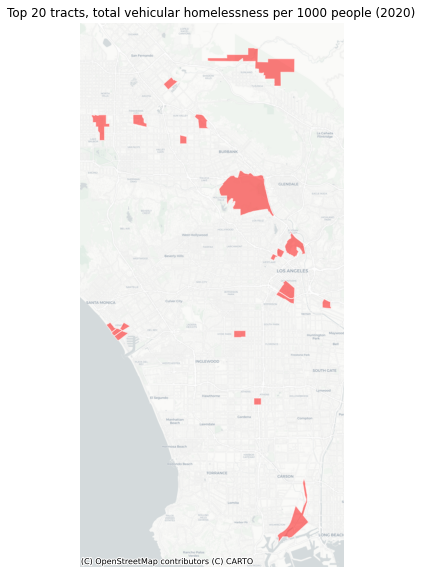

In [13]:
fig,ax = plt.subplots(figsize=(12,10))
merge.sort_values(by='total_per_1000',ascending=False)[:20].plot(ax=ax,
                                                                 color='red',
                                                                 edgecolor='white',
                                                                 alpha=0.5,legend=True)

ax.set_title('Top 20 tracts, total vehicular homelessness per 1000 people (2020)')
ax.axis('off')
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

Right, so kind of what we already knew: industrial NoHo and San Pedro, Venice, the neighborhoods around Downtown. Let's make some chloropleth maps for each type of vehicular homelessness.

/opt/conda/lib/python3.9/site-packages/mapclassify/classifiers.py:238: UserWarning: Warning: Not enough unique values in array to form k classes
  Warn(
/opt/conda/lib/python3.9/site-packages/mapclassify/classifiers.py:241: UserWarning: Warning: setting k to 4
  Warn("Warning: setting k to %d" % k_q, UserWarning)
/opt/conda/lib/python3.9/site-packages/mapclassify/classifiers.py:238: UserWarning: Warning: Not enough unique values in array to form k classes
  Warn(
/opt/conda/lib/python3.9/site-packages/mapclassify/classifiers.py:241: UserWarning: Warning: setting k to 4
  Warn("Warning: setting k to %d" % k_q, UserWarning)
/opt/conda/lib/python3.9/site-packages/mapclassify/classifiers.py:238: UserWarning: Warning: Not enough unique values in array to form k classes
  Warn(
/opt/conda/lib/python3.9/site-packages/mapclassify/classifiers.py:241: UserWarning: Warning: setting k to 4
  Warn("Warning: setting k to %d" % k_q, UserWarning)


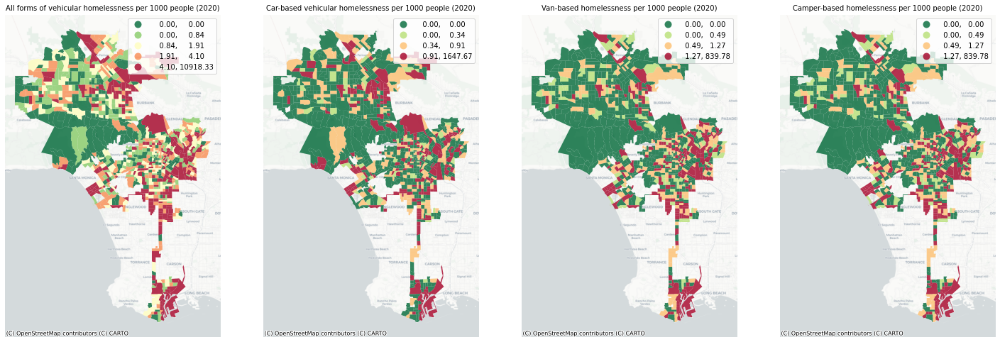

In [14]:
fig,axs = plt.subplots(1,4,figsize=(25,25))
ax1, ax2, ax3, ax4 = axs

merge.plot(ax=ax1,
        column='total_per_1000',
        legend=True,
        alpha=0.8,
        cmap='RdYlGn_r',
        scheme='quantiles')
ax1.axis('off')
ax1.set_title('All forms of vehicular homelessness per 1000 people (2020)',fontsize=10)
ctx.add_basemap(ax1,source=ctx.providers.CartoDB.Positron)

merge.plot(ax=ax2,
        column='cars_per_1000',
        legend=True,
        alpha=0.8,
        cmap='RdYlGn_r',
        scheme='quantiles')
ax2.axis('off')
ax2.set_title('Car-based vehicular homelessness per 1000 people (2020)',fontsize=10)
ctx.add_basemap(ax2,source=ctx.providers.CartoDB.Positron)

merge.plot(ax=ax3,
        column='vans_per_1000',
        legend=True,
        alpha=0.8,
        cmap='RdYlGn_r',
        scheme='quantiles')
ax3.axis('off')
ax3.set_title('Van-based homelessness per 1000 people (2020)',fontsize=10)
ctx.add_basemap(ax3,source=ctx.providers.CartoDB.Positron)

merge.plot(ax=ax4,
        column='vans_per_1000',
        legend=True,
        alpha=0.8,
        cmap='RdYlGn_r',
        scheme='quantiles')
ax4.axis('off')
ax4.set_title('Camper-based homelessness per 1000 people (2020)',fontsize=10)
ctx.add_basemap(ax4,source=ctx.providers.CartoDB.Positron)

Well, it came out looking alright. Controlling for population, vehicular homelessness may not be nearly as concentrades as I had assumed. (Don't mind the warning messages -- geopandas could only come up with four categories when it normally tries to make five with this scheme.) Let's probe the data a little more.

In [15]:
merge.sort_values('total_per_1000',ascending=False)

,tract,LA,cars,vans,campers,total,geometry,TotalPop,total_per_1000,cars_per_1000,vans_per_1000,campers_per_1000
990,980014,1,14.829,7.558,75.878,98.265,"MULTIPOLYGON (((-13160720.194 4005275.275, -13...",9.0,10918.333333,1647.666667,839.777778,8430.888889
988,980009,1,3.024,0.000,0.000,3.024,"MULTIPOLYGON (((-13169994.109 4050471.069, -13...",5.0,604.800000,604.800000,0.000000,0.000000
987,980008,1,8.036,18.525,9.945,36.506,"MULTIPOLYGON (((-13189711.797 4058558.751, -13...",68.0,536.852941,118.176471,272.426471,146.250000
989,980010,1,4.536,10.644,12.787,27.967,"MULTIPOLYGON (((-13162842.166 4041648.022, -13...",95.0,294.389474,47.747368,112.042105,134.600000
998,980026,1,1.607,0.000,0.000,1.607,"MULTIPOLYGON (((-13167571.463 4068088.313, -13...",26.0,61.807692,61.807692,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...
0,101110,1,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-13168864.105 4064201.309, -13...",4283.0,0.000000,0.000000,0.000000,0.000000
993,980020,1,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-13166031.469 4060067.620, -13...",0.0,NaN,NaN,NaN,NaN
995,980022,1,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-13190187.910 4071190.737, -13...",0.0,NaN,NaN,NaN,NaN
996,980023,1,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-13203329.621 4060459.983, -13...",0.0,NaN,NaN,NaN,NaN


It seems like some tracts with no reported vehicular homelessness were normalized as 'NaN.' Let's fix that.

In [16]:
merge = merge.fillna(0)
merge.sort_values('total_per_1000',ascending=False)

,tract,LA,cars,vans,campers,total,geometry,TotalPop,total_per_1000,cars_per_1000,vans_per_1000,campers_per_1000
990,980014,1,14.829,7.558,75.878,98.265,"MULTIPOLYGON (((-13160720.194 4005275.275, -13...",9.0,10918.333333,1647.666667,839.777778,8430.888889
988,980009,1,3.024,0.000,0.000,3.024,"MULTIPOLYGON (((-13169994.109 4050471.069, -13...",5.0,604.800000,604.800000,0.000000,0.000000
987,980008,1,8.036,18.525,9.945,36.506,"MULTIPOLYGON (((-13189711.797 4058558.751, -13...",68.0,536.852941,118.176471,272.426471,146.250000
989,980010,1,4.536,10.644,12.787,27.967,"MULTIPOLYGON (((-13162842.166 4041648.022, -13...",95.0,294.389474,47.747368,112.042105,134.600000
998,980026,1,1.607,0.000,0.000,1.607,"MULTIPOLYGON (((-13167571.463 4068088.313, -13...",26.0,61.807692,61.807692,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...
200,124500,1,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-13182733.623 4051958.950, -13...",2925.0,0.000000,0.000000,0.000000,0.000000
333,141202,1,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-13184298.441 4048814.032, -13...",2674.0,0.000000,0.000000,0.000000,0.000000
661,219300,1,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-13172433.119 4032874.123, -13...",4239.0,0.000000,0.000000,0.000000,0.000000
204,124903,1,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-13179837.869 4050961.043, -13...",3499.0,0.000000,0.000000,0.000000,0.000000


Let's look into that extreme outlier.

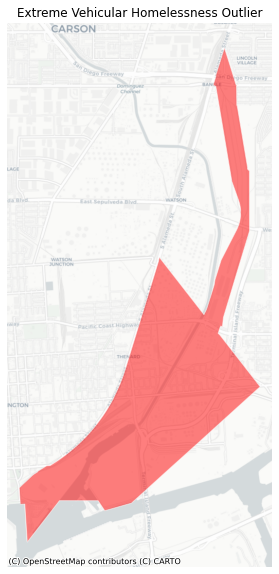

In [17]:
fig,ax = plt.subplots(figsize=(12,10))
merge.sort_values(by='total_per_1000',ascending=False)[:1].plot(ax=ax,
                                                                 color='red',
                                                                 edgecolor='white',
                                                                 alpha=0.5,legend=True)

ax.set_title('Extreme Vehicular Homelessness Outlier')
ax.axis('off')
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

Checking it against Google Maps, this is a heavily industrial area of San Pedro. An unusually high rate of camper-based homelessness is plausible here.

### 1.3 Diamonds, Donuts, and Spatial Lag

I'll be analyzing total vehicular homelessness in this section, but I'm going to go ahead and tee up the data for the three specific types, since I know that they each behave differently, spatially speaking. I'll analyze each in turn later on in this notebook.

First I need to add a contiguity weight. (I had previously used a KNN weight, but after testing, this weight better accomodates the rather large size of the industrial tracts where vehicular homelessness seems to be concentrated.) I pass the argument 'Rook' to have it consider neighbors with shared edges.

In [18]:
wq = weights.contiguity.Rook.from_dataframe(merge)
wq.transform = 'r'

Next I'm going to figure out the spatial lag, so I can identify the donut -- a tract with low vehicular homelessness surrounded by high vehicular homelessness -- and the diamond -- the inverse.

In [19]:
merge['total_per_1000_lag'] = lps.weights.lag_spatial(wq, merge['total_per_1000'])
merge['cars_per_1000_lag'] = lps.weights.lag_spatial(wq, merge['cars_per_1000'])
merge['vans_per_1000_lag'] = lps.weights.lag_spatial(wq, merge['vans_per_1000'])
merge['campers_per_1000_lag'] = lps.weights.lag_spatial(wq, merge['campers_per_1000'])

And now, to identify the head and tail:

In [20]:
merge['total_lag_diff'] = merge['total_per_1000'] - merge['total_per_1000_lag']
merge['cars_lag_diff'] = merge['cars_per_1000'] - merge['cars_per_1000_lag']
merge['vans_lag_diff'] = merge['vans_per_1000'] - merge['vans_per_1000_lag']
merge['campers_lag_diff'] = merge['campers_per_1000'] - merge['campers_per_1000_lag']

Let's find the donut for total vehicular homelessness.

In [21]:
total_donut = merge.sort_values(by='total_lag_diff').head(1)
total_donut

,tract,LA,cars,vans,campers,total,geometry,TotalPop,total_per_1000,cars_per_1000,vans_per_1000,campers_per_1000,total_per_1000_lag,cars_per_1000_lag,vans_per_1000_lag,campers_per_1000_lag,total_lag_diff,cars_lag_diff,vans_lag_diff,campers_lag_diff
961,294620,1,0.0,0.0,3.299,3.299,"MULTIPOLYGON (((-13162779.938 3999932.620, -13...",4683.0,0.704463,0.0,0.0,0.704463,2735.024431,412.042085,211.536198,2111.446148,-2734.319968,-412.042085,-211.536198,-2110.741685


This doesn't tell me much. Let's go ahead and map it.

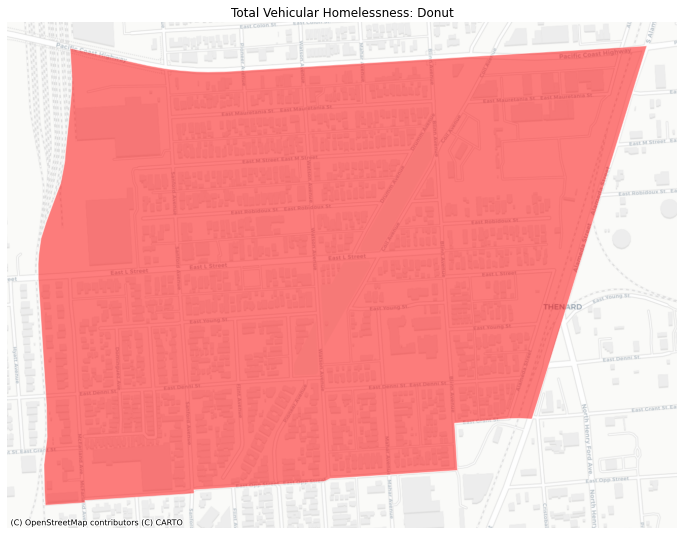

In [22]:
fig,ax = plt.subplots(figsize=(12,10))
total_donut.plot(ax=ax,
                     color='red',
                     edgecolor='white',
                     alpha=0.5,legend=True)

ax.set_title('Total Vehicular Homelessness: Donut')
ax.axis('off')
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

So it's the residential neighborhood next to that extreme outlier that we identified in San Pedro. Let's go ahead and identify all the donuts and diamond and map a few using Plotly Express and its Mapbox Satellite.

It would be cool if a few of these donuts were in OPDs, as it would confirm my suspicion that they are being mapped to exclude vehicular homelessness.

In [23]:
total_diamond = merge.sort_values(by='total_lag_diff').tail(1)
total_diamond

,tract,LA,cars,vans,campers,total,geometry,TotalPop,total_per_1000,cars_per_1000,vans_per_1000,campers_per_1000,total_per_1000_lag,cars_per_1000_lag,vans_per_1000_lag,campers_per_1000_lag,total_lag_diff,cars_lag_diff,vans_lag_diff,campers_lag_diff
990,980014,1,14.829,7.558,75.878,98.265,"MULTIPOLYGON (((-13160720.194 4005275.275, -13...",9.0,10918.333333,1647.666667,839.777778,8430.888889,7.459328,0.699036,1.741897,5.018396,10910.874005,1646.967631,838.035881,8425.870493


Look familiar? It's our old friend industrial San Pedro.

In [24]:
cars_donut = merge.sort_values(by='cars_lag_diff').head(1)
cars_donut

,tract,LA,cars,vans,campers,total,geometry,TotalPop,total_per_1000,cars_per_1000,vans_per_1000,campers_per_1000,total_per_1000_lag,cars_per_1000_lag,vans_per_1000_lag,campers_per_1000_lag,total_lag_diff,cars_lag_diff,vans_lag_diff,campers_lag_diff
961,294620,1,0.0,0.0,3.299,3.299,"MULTIPOLYGON (((-13162779.938 3999932.620, -13...",4683.0,0.704463,0.0,0.0,0.704463,2735.024431,412.042085,211.536198,2111.446148,-2734.319968,-412.042085,-211.536198,-2110.741685


In [25]:
cars_diamond = merge.sort_values(by='cars_lag_diff').tail(1)
cars_diamond

,tract,LA,cars,vans,campers,total,geometry,TotalPop,total_per_1000,cars_per_1000,vans_per_1000,campers_per_1000,total_per_1000_lag,cars_per_1000_lag,vans_per_1000_lag,campers_per_1000_lag,total_lag_diff,cars_lag_diff,vans_lag_diff,campers_lag_diff
990,980014,1,14.829,7.558,75.878,98.265,"MULTIPOLYGON (((-13160720.194 4005275.275, -13...",9.0,10918.333333,1647.666667,839.777778,8430.888889,7.459328,0.699036,1.741897,5.018396,10910.874005,1646.967631,838.035881,8425.870493


There she is again.

In [26]:
vans_donut = merge.sort_values(by='vans_lag_diff').head(1)
vans_donut

,tract,LA,cars,vans,campers,total,geometry,TotalPop,total_per_1000,cars_per_1000,vans_per_1000,campers_per_1000,total_per_1000_lag,cars_per_1000_lag,vans_per_1000_lag,campers_per_1000_lag,total_lag_diff,cars_lag_diff,vans_lag_diff,campers_lag_diff
961,294620,1,0.0,0.0,3.299,3.299,"MULTIPOLYGON (((-13162779.938 3999932.620, -13...",4683.0,0.704463,0.0,0.0,0.704463,2735.024431,412.042085,211.536198,2111.446148,-2734.319968,-412.042085,-211.536198,-2110.741685


In [27]:
vans_diamond = merge.sort_values(by='vans_lag_diff').tail(1)
vans_diamond

,tract,LA,cars,vans,campers,total,geometry,TotalPop,total_per_1000,cars_per_1000,vans_per_1000,campers_per_1000,total_per_1000_lag,cars_per_1000_lag,vans_per_1000_lag,campers_per_1000_lag,total_lag_diff,cars_lag_diff,vans_lag_diff,campers_lag_diff
990,980014,1,14.829,7.558,75.878,98.265,"MULTIPOLYGON (((-13160720.194 4005275.275, -13...",9.0,10918.333333,1647.666667,839.777778,8430.888889,7.459328,0.699036,1.741897,5.018396,10910.874005,1646.967631,838.035881,8425.870493


This may end up being the diamond across all types of vehicular homelessness. It's certainly going to be the camper diamond.

In [28]:
campers_donut = merge.sort_values(by='campers_lag_diff').head(1)
campers_donut

,tract,LA,cars,vans,campers,total,geometry,TotalPop,total_per_1000,cars_per_1000,vans_per_1000,campers_per_1000,total_per_1000_lag,cars_per_1000_lag,vans_per_1000_lag,campers_per_1000_lag,total_lag_diff,cars_lag_diff,vans_lag_diff,campers_lag_diff
961,294620,1,0.0,0.0,3.299,3.299,"MULTIPOLYGON (((-13162779.938 3999932.620, -13...",4683.0,0.704463,0.0,0.0,0.704463,2735.024431,412.042085,211.536198,2111.446148,-2734.319968,-412.042085,-211.536198,-2110.741685


In [29]:
campers_diamond = merge.sort_values(by='campers_lag_diff').tail(1)
campers_diamond

,tract,LA,cars,vans,campers,total,geometry,TotalPop,total_per_1000,cars_per_1000,vans_per_1000,campers_per_1000,total_per_1000_lag,cars_per_1000_lag,vans_per_1000_lag,campers_per_1000_lag,total_lag_diff,cars_lag_diff,vans_lag_diff,campers_lag_diff
990,980014,1,14.829,7.558,75.878,98.265,"MULTIPOLYGON (((-13160720.194 4005275.275, -13...",9.0,10918.333333,1647.666667,839.777778,8430.888889,7.459328,0.699036,1.741897,5.018396,10910.874005,1646.967631,838.035881,8425.870493


Ladies and gentlemen, we have consistent donuts and diamonds for all forms of vehicular homelessness.

Let's map those diamonds and donuts in Plotly Express and its Mapbox Satellite.

In [30]:
token = 'pk.eyJ1IjoieW9obWFuIiwiYSI6IkxuRThfNFkifQ.u2xRJMiChx914U7mOZMiZw'
px.set_mapbox_access_token(token)

In [31]:
total_diamond= total_diamond.to_crs('epsg:4326')
minx, miny, maxx, maxy = total_diamond.geometry.total_bounds
center_lat_total_diamond = (maxy-miny)/2+miny
center_lon_total_diamond = (maxx-minx)/2+minx

total_donut = total_donut.to_crs('epsg:4326')
minx, miny, maxx, maxy = total_donut.geometry.total_bounds
center_lat_total_donut = (maxy-miny)/2+miny
center_lon_total_donut = (maxx-minx)/2+minx

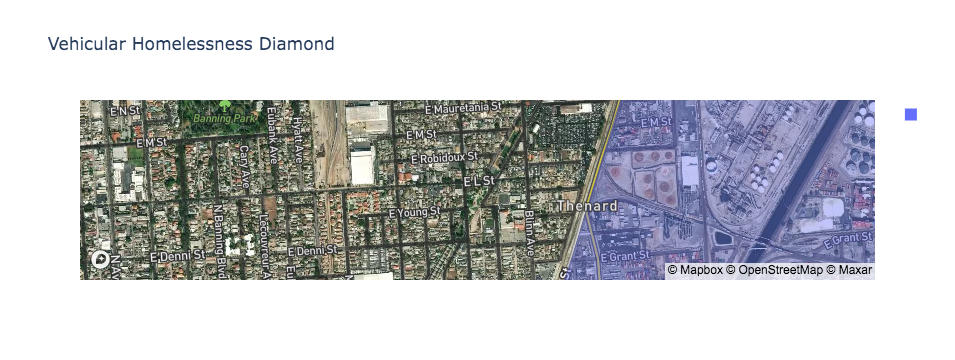

In [32]:
px.choropleth_mapbox(total_diamond, 
                     geojson=total_diamond.geometry, 
                     locations=total_diamond.index, 
                     mapbox_style="satellite-streets",
                     zoom=14, 
                     center = {"lat": center_lat_total_donut, "lon": center_lon_total_donut},
                     opacity=0.4,
                     title='Vehicular Homelessness Diamond')

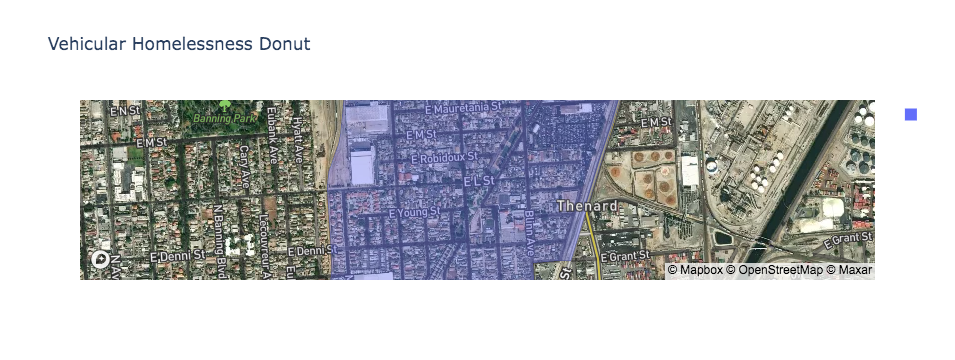

In [33]:
px.choropleth_mapbox(total_donut, 
                     geojson=total_donut.geometry, 
                     locations=total_donut.index, 
                     mapbox_style="satellite-streets",
                     zoom=14, 
                     center = {"lat": center_lat_total_donut, "lon": center_lon_total_donut},
                     opacity=0.4,
                     title='Vehicular Homelessness Donut')

Let's see how these maps change with a spatial lag added in.

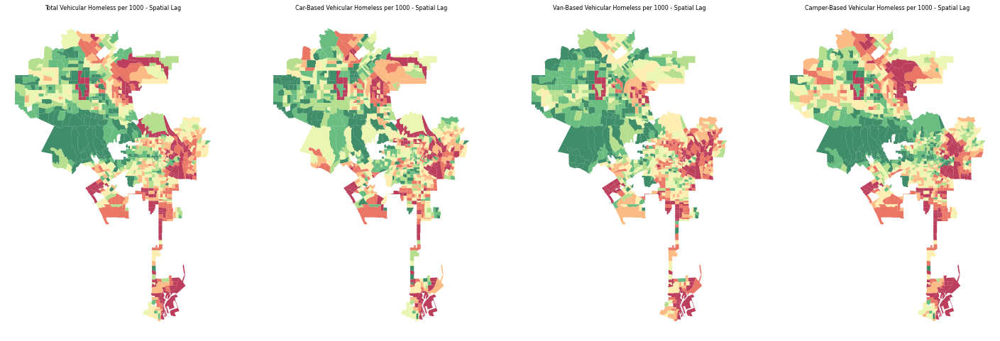

In [34]:
fig, axs = plt.subplots(1, 4, figsize=(25, 25))

ax1, ax2, ax3, ax4 = axs

merge.plot(ax=ax1,
         column='total_per_1000_lag', 
         cmap='RdYlGn_r', 
         scheme='quantiles',
         k=8, 
         edgecolor='white', 
         linewidth=0, 
         alpha=0.75, 
           )
ax1.axis("off")
ax1.set_title("Total Vehicular Homeless per 1000 - Spatial Lag",fontsize=8)

merge.plot(ax=ax2,
         column='cars_per_1000_lag', 
         cmap='RdYlGn_r', 
         scheme='quantiles',
         k=8, 
         edgecolor='white', 
         linewidth=0, 
         alpha=0.75, 
           )
ax2.axis("off")
ax2.set_title("Car-Based Vehicular Homeless per 1000 - Spatial Lag",fontsize=8)

merge.plot(ax=ax3,
         column='vans_per_1000_lag', 
         cmap='RdYlGn_r', 
         scheme='quantiles',
         k=8, 
         edgecolor='white', 
         linewidth=0, 
         alpha=0.75, 
           )
ax3.axis("off")
ax3.set_title("Van-Based Vehicular Homeless per 1000 - Spatial Lag",fontsize=8)

merge.plot(ax=ax4,
         column='campers_per_1000_lag', 
         cmap='RdYlGn_r', 
         scheme='quantiles',
         k=8, 
         edgecolor='white', 
         linewidth=0, 
         alpha=0.75, 
           )
ax4.axis("off")
ax4.set_title("Camper-Based Vehicular Homeless per 1000 - Spatial Lag",fontsize=8)

plt.show()

Cool, so this mostly affirms what we already knew, but with lightly more chaotic maps. You can see the effect of spatial lag. Let's make an interactive version for total vehicular homelessness.

In [35]:
merge_web = merge.to_crs('EPSG:4326')

In [36]:
minx, miny, maxx, maxy = merge_web.geometry.total_bounds
center_lat_merge_web = (maxy-miny)/2+miny
center_lon_merge_web = (maxx-minx)/2+minx

In [37]:
merge_web.total_per_1000_lag.describe()

count    1001.000000
mean       14.381053
std       144.141144
min         0.000000
25%         1.024752
50%         2.086028
75%         3.904154
max      2735.024431
Name: total_per_1000_lag, dtype: float64

In [38]:
median = merge_web.total_per_1000_lag.median()

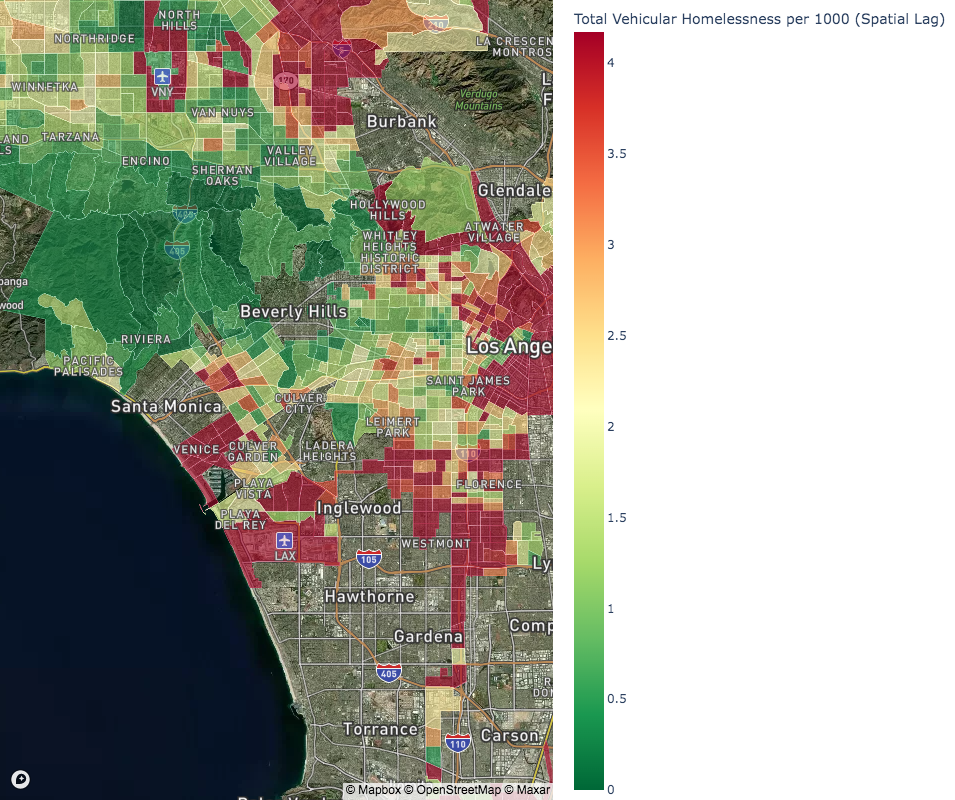

In [39]:
fig = px.choropleth_mapbox(merge_web, 
                     geojson=merge_web.geometry,
                     locations=merge_web.index,
                     mapbox_style="satellite-streets",
                     zoom=10, 
                     color='total_per_1000_lag',
                     color_continuous_scale='RdYlGn_r',
                     color_continuous_midpoint = median,
                     range_color =(0,median*2),
                     hover_data=['tract','TotalPop','total_per_1000','total_per_1000_lag','cars_per_1000','cars_per_1000_lag','vans_per_1000','vans_per_1000_lag','campers_per_1000_lag','campers_per_1000_lag'],
                     center = {"lat": center_lat_merge_web, "lon": center_lon_merge_web},
                     opacity=0.6,
                     width=1000,
                     height=800,
                     labels={
                             'total_per_1000_lag':'Total Vehicular Homelessness per 1000 (Spatial Lag)',
                             'total_per_1000':'Total Vehicular Homelessness per 1000',
                     })
fig.update_traces(marker_line_width=0.1, marker_line_color='white')
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

This makes the data about a million times easier to explore. I can't help but notice how closely this tracks onto general arrest data. Are the vehicular homeless more likely to commit crimes? Or are they simply more likely to be bothered by law enforcement? Or, even worse: are we shuffling the vehicular homeless into high-crime tracts?

### 1.4 Moran's Plot (Standard Dataset)

Okay, let's start on this Moran business.  First, the global autocorrelation.

In [40]:
y = merge.total_per_1000
moran_total = Moran(y, wq)
moran_total.I

-0.0004828798860431127

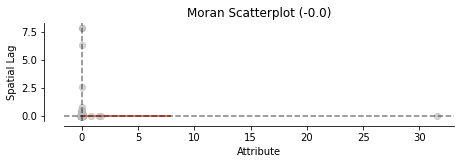

In [41]:
fig, ax = moran_scatterplot(moran_total, aspect_equal=True)
plt.show()

Weirdly, the figure is negative, and ever so slightly so, which means that similar values tend to be far from one another; that is to say, tracts with high vehicular homelessness do not colocate. I wonder how the extreme outlier in San Pedro is affecting this? Would it be appropriate to remove it?

(<Figure size 504x504 with 1 Axes>,
 <AxesSubplot:title={'center':'Reference Distribution'}, xlabel='Moran I: -0.0', ylabel='Density'>)

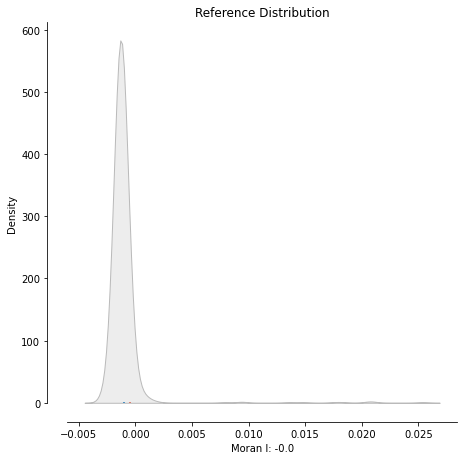

In [42]:
plot_moran_simulation(moran_total,aspect_equal=False)

In [43]:
moran_total.p_sim

0.072

So what does this mean? Apparently alike tracts are removed from one another at statistically significant rates at (barely) 90% confidence. Evidently vehicular homelessness isn't nearly as clustered as I assumed it might be. Could the deployment of more OPDs change that?

I'm now going to run the Local Indicators of Spatial Association (LISA) analysis. If LH tracts are within OPDs, it would partially affirm my hypothesis.

### 1.5 Local Spatial Autocorrelation (Standard Dataset)

In [44]:
lisa_total = esda.moran.Moran_Local(y, wq)

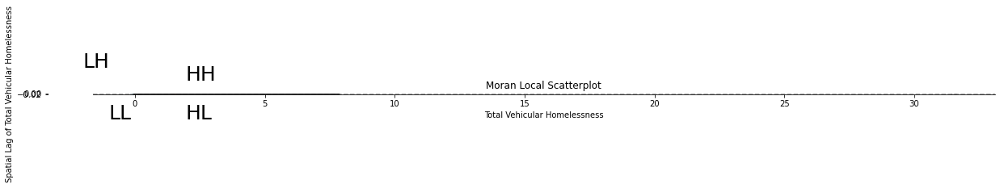

In [45]:
fig,ax = plt.subplots(figsize=(20,15))

moran_scatterplot(lisa_total, ax=ax, p=0.05)
ax.set_xlabel("Total Vehicular Homelessness")
ax.set_ylabel('Spatial Lag of Total Vehicular Homelessness')


plt.text(1.95, 0.5, "HH", fontsize=25)
plt.text(1.95, -1, "HL", fontsize=25)
plt.text(-2, 1, "LH", fontsize=25)
plt.text(-1, -1, "LL", fontsize=25)
plt.show()

That doesn't look right! This is almost certainly the result of those outliers. I will need to rerun it after removing them.

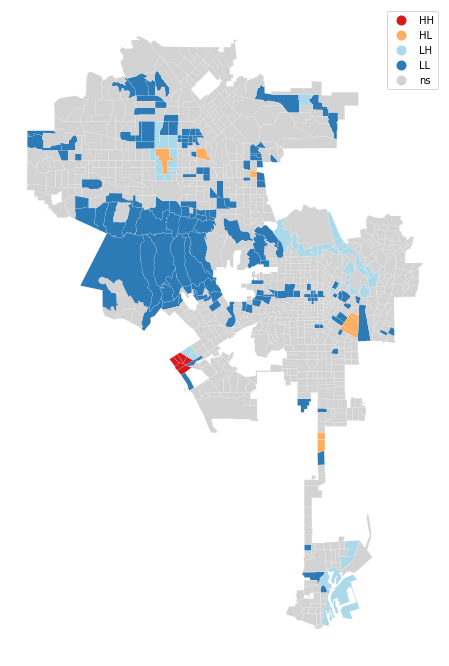

In [46]:
fig, ax = plt.subplots(figsize=(14,12))
lisa_cluster(lisa_total, merge, p=0.05, ax=ax)
plt.show()

That looks *kind of* right. Some of this is to be expected: concentrations in Venice, little vehicular homelessness in affluent neighborhoods in the hills, etc. There does seem to be a LH in Venice that benefits from an OPD. But a lot of this isn't expected: Downtown and industrial areas of North Hollywood and South Los Angeles somehow don't show up as HHs?

Let's check it at three levels of significance.

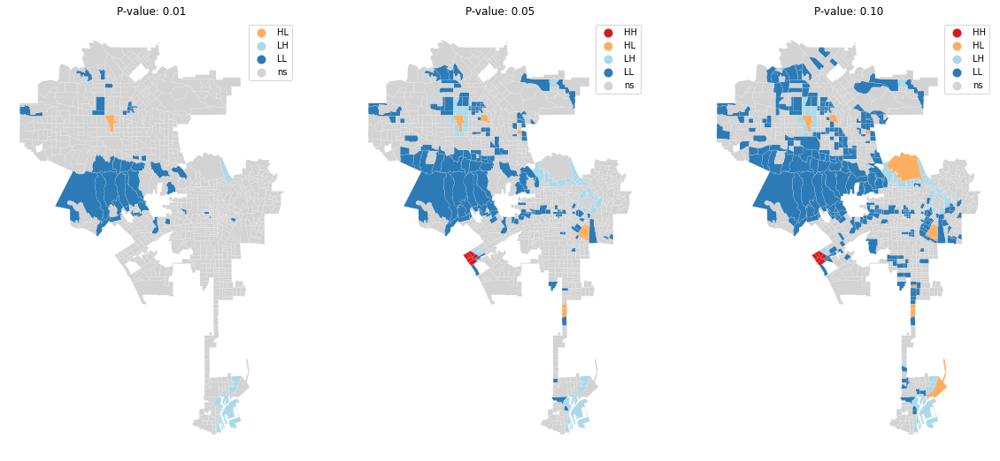

In [47]:
fig, axs = plt.subplots(1, 3, figsize=(20, 12))
ax1, ax2, ax3 = axs

lisa_cluster(lisa_total, merge, p=0.01, ax=ax1)
ax1.axis("off")
ax1.set_title("P-value: 0.01")

lisa_cluster(lisa_total, merge, p=0.05, ax=ax2)
ax2.axis("off")
ax2.set_title("P-value: 0.05")

lisa_cluster(lisa_total, merge, p=0.10, ax=ax3)
ax3.axis("off")
ax3.set_title("P-value: 0.10")


plt.show()

So there you have it: the significant autocorrelation is overwhelmingly among LL tracts. Exceptions to this are HH tracts in Venice and HL tracts around Downtown. Let's see what happens when we remove the extreme outlier.

### 1.6 Moran 1 (Removing Extreme Outlier)

Let's remove that *extreme* outlier, Tract , which exhibited a vehicular homelessness rate of 10,918 per 10,000 residents. This is an industrial area, so I don't doubt that it's truely that extreme, but it may be fooling with the data. It certainly prevents us from producing usable charts.

In [48]:
merge_sorted = merge.sort_values('total_per_1000',ascending=False)
mergem1 = merge_sorted.iloc[1:]
mergem1

,tract,LA,cars,vans,campers,total,geometry,TotalPop,total_per_1000,cars_per_1000,vans_per_1000,campers_per_1000,total_per_1000_lag,cars_per_1000_lag,vans_per_1000_lag,campers_per_1000_lag,total_lag_diff,cars_lag_diff,vans_lag_diff,campers_lag_diff
988,980009,1,3.024,0.000,0.000,3.024,"MULTIPOLYGON (((-13169994.109 4050471.069, -13...",5.0,604.800000,604.800000,0.000000,0.000000,1.183587,0.298968,0.600526,0.284092,603.616413,604.501032,-0.600526,-0.284092
987,980008,1,8.036,18.525,9.945,36.506,"MULTIPOLYGON (((-13189711.797 4058558.751, -13...",68.0,536.852941,118.176471,272.426471,146.250000,0.589539,0.091810,0.199279,0.298449,536.263402,118.084660,272.227191,145.951551
989,980010,1,4.536,10.644,12.787,27.967,"MULTIPOLYGON (((-13162842.166 4041648.022, -13...",95.0,294.389474,47.747368,112.042105,134.600000,5.231248,0.846500,1.317353,3.067394,289.158226,46.900868,110.724752,131.532606
998,980026,1,1.607,0.000,0.000,1.607,"MULTIPOLYGON (((-13167571.463 4068088.313, -13...",26.0,61.807692,61.807692,0.000000,0.000000,1.376296,0.410009,0.272026,0.694260,60.431396,61.397683,-0.272026,-0.694260
551,208402,1,57.461,56.770,41.204,155.435,"MULTIPOLYGON (((-13164778.123 4038153.723, -13...",2896.0,53.672307,19.841506,19.602901,14.227901,3.568385,0.722086,2.016124,0.830175,50.103922,19.119420,17.586777,13.397725
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
200,124500,1,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-13182733.623 4051958.950, -13...",2925.0,0.000000,0.000000,0.000000,0.000000,0.768669,0.000000,0.148624,0.620045,-0.768669,0.000000,-0.148624,-0.620045
333,141202,1,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-13184298.441 4048814.032, -13...",2674.0,0.000000,0.000000,0.000000,0.000000,0.341218,0.000000,0.080820,0.260397,-0.341218,0.000000,-0.080820,-0.260397
661,219300,1,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-13172433.119 4032874.123, -13...",4239.0,0.000000,0.000000,0.000000,0.000000,3.136065,0.594231,1.088647,1.453187,-3.136065,-0.594231,-1.088647,-1.453187
204,124903,1,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-13179837.869 4050961.043, -13...",3499.0,0.000000,0.000000,0.000000,0.000000,0.357537,0.000000,0.000000,0.357537,-0.357537,0.000000,0.000000,-0.357537


Let's run global autocorrelation again.

In [49]:
wr = weights.contiguity.Rook.from_dataframe(mergem1)
wr.transform = 'r'
z = mergem1.total_per_1000
moranm1_total = Moran(z, wr)
moranm1_total.I

-0.0030082094033942706

Interesting, so it didn't change the relationship all that much: it's still negative and quite small.fig, ax = moran_scatterplot(moran_total, aspect_equal=True)
plt.show()

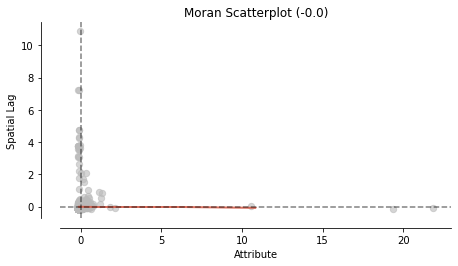

In [50]:
fig, ax = moran_scatterplot(moranm1_total, aspect_equal=True)
plt.show()

This is still pretty goofy, presumably owing to the other four entries over 100. "

(<Figure size 504x504 with 1 Axes>,
 <AxesSubplot:title={'center':'Reference Distribution'}, xlabel='Moran I: -0.0', ylabel='Density'>)

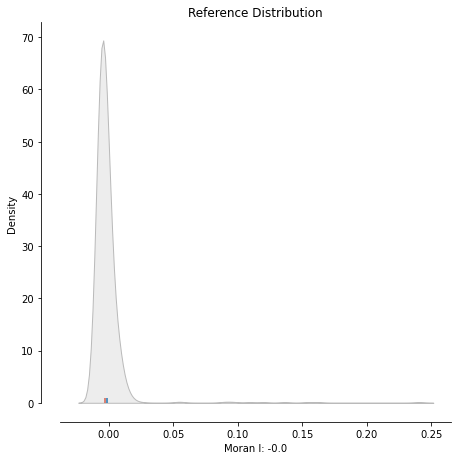

In [51]:
plot_moran_simulation(moranm1_total,aspect_equal=False)

In [52]:
moranm1_total.p_sim

0.427

Oh wow, so there's no significant relationship here without the outlier. Like, none at all! So we can't say with anything with confidence about the clustering of vehicular homelesness, sans outlier.

### 1.7 Local Spatial Autocorrelation (Removing Extreme Outlier)

Let's try the local spatial autocorrelation again, without the outlier.

In [53]:
lisam1_total = esda.moran.Moran_Local(z, wr)

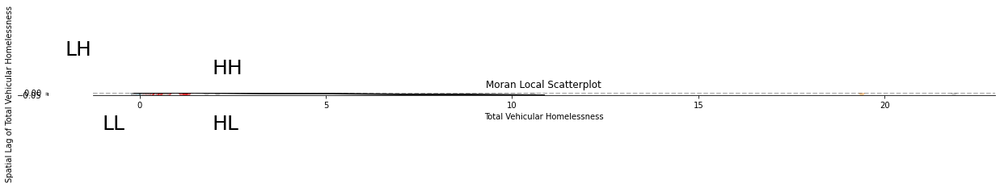

In [54]:
fig,ax = plt.subplots(figsize=(20,15))

moran_scatterplot(lisam1_total, ax=ax, p=0.05)
ax.set_xlabel("Total Vehicular Homelessness")
ax.set_ylabel('Spatial Lag of Total Vehicular Homelessness')


plt.text(1.95, 0.5, "HH", fontsize=25)
plt.text(1.95, -1, "HL", fontsize=25)
plt.text(-2, 1, "LH", fontsize=25)
plt.text(-1, -1, "LL", fontsize=25)
plt.show()

Huh, so this looks slightly less useless? *Long exhale* Let's map it, I suppose.

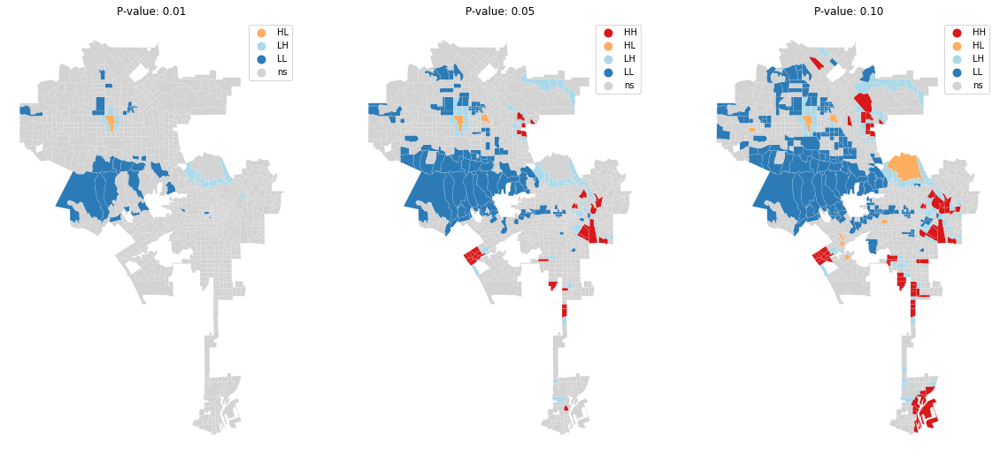

In [55]:
fig, axs = plt.subplots(1, 3, figsize=(20, 12))
ax1, ax2, ax3 = axs

lisa_cluster(lisam1_total, mergem1, p=0.01, ax=ax1)
ax1.axis("off")
ax1.set_title("P-value: 0.01")

lisa_cluster(lisam1_total, mergem1, p=0.05, ax=ax2)
ax2.axis("off")
ax2.set_title("P-value: 0.05")

lisa_cluster(lisam1_total, mergem1, p=0.10, ax=ax3)
ax3.axis("off")
ax3.set_title("P-value: 0.10")


plt.show()

Well, this LISA analysis at least looks quite a bit more accurate: it's capturing all the hotspots we identified during the midterm, e.g. Venice, North Hollywood, Downtown, South Los Angeles.

### 1.8 Moran 1 (Removing Top 4 Outiers)

Let's try one more thing: removing all four of the records that are over 100 in terms of total_per_1000. 

In [56]:
mergem4 = merge_sorted.iloc[4:]
mergem4

,tract,LA,cars,vans,campers,total,geometry,TotalPop,total_per_1000,cars_per_1000,vans_per_1000,campers_per_1000,total_per_1000_lag,cars_per_1000_lag,vans_per_1000_lag,campers_per_1000_lag,total_lag_diff,cars_lag_diff,vans_lag_diff,campers_lag_diff
998,980026,1,1.607,0.000,0.000,1.607,"MULTIPOLYGON (((-13167571.463 4068088.313, -13...",26.0,61.807692,61.807692,0.000000,0.000000,1.376296,0.410009,0.272026,0.694260,60.431396,61.397683,-0.272026,-0.694260
551,208402,1,57.461,56.770,41.204,155.435,"MULTIPOLYGON (((-13164778.123 4038153.723, -13...",2896.0,53.672307,19.841506,19.602901,14.227901,3.568385,0.722086,2.016124,0.830175,50.103922,19.119420,17.586777,13.397725
908,273502,1,10.490,94.466,9.612,114.568,"MULTIPOLYGON (((-13187570.566 4027544.471, -13...",2861.0,40.044740,3.666550,33.018525,3.359664,27.278148,5.187904,12.556822,9.533421,12.766592,-1.521354,20.461703,-6.173757
909,273600,1,10.490,54.231,25.633,90.354,"MULTIPOLYGON (((-13186818.269 4028422.033, -13...",2375.0,38.043789,4.416842,22.834105,10.792842,18.137878,1.987484,11.019461,5.130933,19.905912,2.429358,11.814644,5.661910
702,226002,1,12.097,14.193,42.625,68.915,"MULTIPOLYGON (((-13162261.969 4033500.356, -13...",1820.0,37.865385,6.646703,7.798352,23.420330,8.104400,2.017002,1.965987,4.121412,29.760984,4.629702,5.832365,19.298918
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
200,124500,1,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-13182733.623 4051958.950, -13...",2925.0,0.000000,0.000000,0.000000,0.000000,0.768669,0.000000,0.148624,0.620045,-0.768669,0.000000,-0.148624,-0.620045
333,141202,1,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-13184298.441 4048814.032, -13...",2674.0,0.000000,0.000000,0.000000,0.000000,0.341218,0.000000,0.080820,0.260397,-0.341218,0.000000,-0.080820,-0.260397
661,219300,1,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-13172433.119 4032874.123, -13...",4239.0,0.000000,0.000000,0.000000,0.000000,3.136065,0.594231,1.088647,1.453187,-3.136065,-0.594231,-1.088647,-1.453187
204,124903,1,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-13179837.869 4050961.043, -13...",3499.0,0.000000,0.000000,0.000000,0.000000,0.357537,0.000000,0.000000,0.357537,-0.357537,0.000000,0.000000,-0.357537


In [57]:
ws = weights.contiguity.Rook.from_dataframe(mergem4)
ws.transform = 'r'
a = mergem4.total_per_1000
moranm4_total = Moran(a, ws)
moranm4_total.I

0.2818036790141935

So after torturing the data, the relationship is starting to look like what you might expect: a modest positive relationship, suggesting clustering.

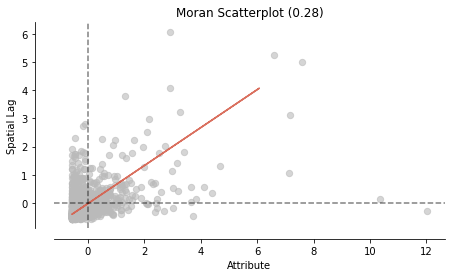

In [58]:
fig, ax = moran_scatterplot(moranm4_total, aspect_equal=True)
plt.show()

And what do you know, finally a Moran Scatterplot that looks basically correct.

(<Figure size 504x504 with 1 Axes>,
 <AxesSubplot:title={'center':'Reference Distribution'}, xlabel='Moran I: 0.28', ylabel='Density'>)

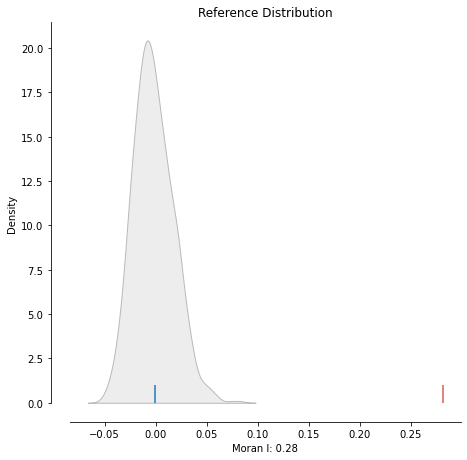

In [59]:
plot_moran_simulation(moranm4_total,aspect_equal=False)

In [60]:
moranm4_total.p_sim

0.001

And what do you know? It's even a significant relationship.

### 1.9 Local Spatial Autocorrelation (Removing Top 4 Outliers)

So the Moran I analysis looks basically coherent with the four outliers removed. What about LISA?

In [61]:
lisam4_total = esda.moran.Moran_Local(a, ws)

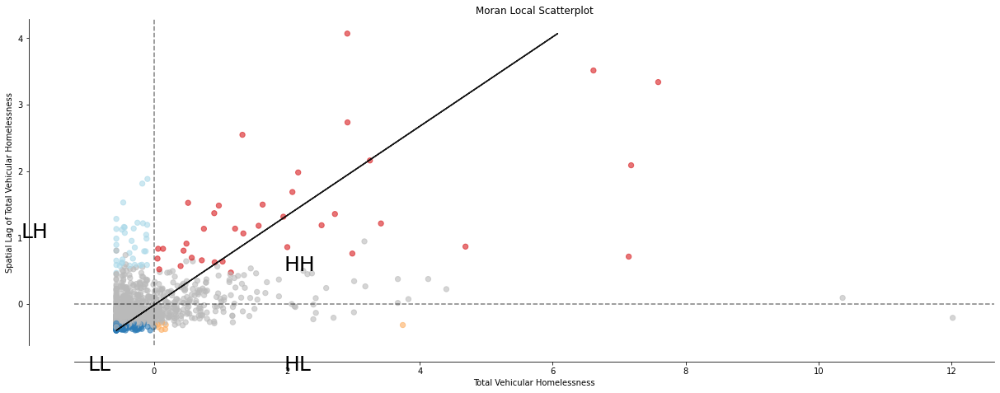

In [62]:
fig,ax = plt.subplots(figsize=(20,15))

moran_scatterplot(lisam4_total, ax=ax, p=0.05)
ax.set_xlabel("Total Vehicular Homelessness")
ax.set_ylabel('Spatial Lag of Total Vehicular Homelessness')


plt.text(1.95, 0.5, "HH", fontsize=25)
plt.text(1.95, -1, "HL", fontsize=25)
plt.text(-2, 1, "LH", fontsize=25)
plt.text(-1, -1, "LL", fontsize=25)
plt.show()

Wow, this is exciting, seeing output that makes sense. Colored points are significant. Let's map them.

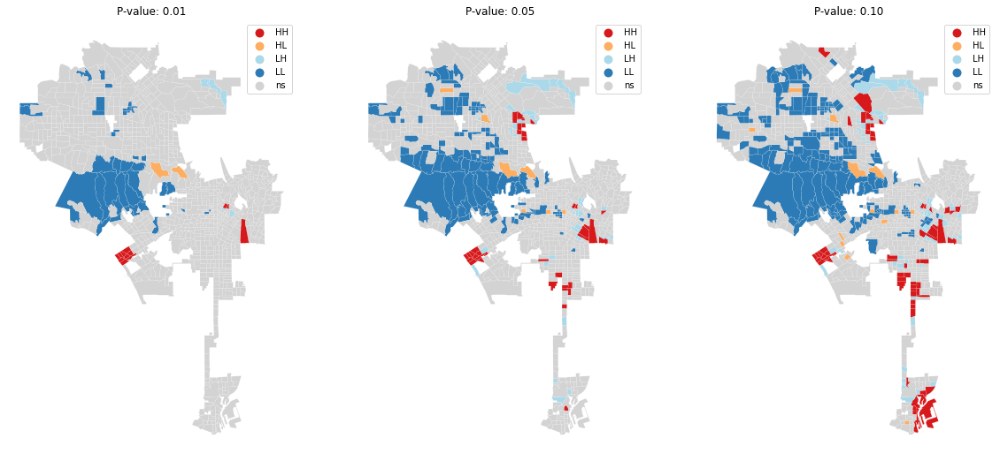

In [63]:
fig, axs = plt.subplots(1, 3, figsize=(20, 12))
ax1, ax2, ax3 = axs

lisa_cluster(lisam4_total, mergem4, p=0.01, ax=ax1)
ax1.axis("off")
ax1.set_title("P-value: 0.01")

lisa_cluster(lisam4_total, mergem4, p=0.05, ax=ax2)
ax2.axis("off")
ax2.set_title("P-value: 0.05")

lisa_cluster(lisam4_total, mergem4, p=0.10, ax=ax3)
ax3.axis("off")
ax3.set_title("P-value: 0.10")


plt.show()

Removing the four extreme outliers, all of this output captures what we have inferred from past analysis: that vehicular homelessness is clustered, mainly in Venice, North Hollywood, Downtown, and South Los Angeles. Still, I'm uneasy about the removal of those four tracts -- they are not errors, but the actual site of extreme rates of vehicular homelessness. I intend to discuss this issue more with a statistician before moving forward with the subsequent research.

## 2. Changes in Vehicular Homelessness, 2016 to 2020

Let's now connect the 2016 homeless count data to this dataset and see what we can say about how the geography of vehicular homelessness has changed over time.

### 2.1 Prepping the Data

I start by importing the 2016 LAHSA count.

In [64]:
count2016 = gpd.read_file('Data/2016-homeless-count-USE-ME.csv')
count2016.head(5)

,censusTract,Year,City,CommunityName,Detailed_Name,SPA,SD,CD,SSD,AD,...,totSHYouthFamHH,totShYouthFamMemb,totShYouthUnaccYouth,totUnsheltPeople,totESPeople,totTHPeople,totSHPeople,totSheltPeople,totPeople,geometry
0,101110,2016,Los Angeles,Sunland-Tujunga,Sunland-Tujunga NC,2,5,7,25,39,...,0,0,0,6,0,0,0,0,6,None
1,101122,2016,Los Angeles,Sunland-Tujunga,Sunland-Tujunga NC,2,5,7,25,39,...,0,0,0,6,0,0,0,0,6,None
2,101210,2016,Los Angeles,Sunland-Tujunga,Sunland-Tujunga NC,2,5,7,25,39,...,0,0,0,19,0,0,0,0,19,None
3,101220,2016,Los Angeles,Sunland-Tujunga,Sunland-Tujunga NC,2,5,7,25,39,...,0,0,0,39,0,0,0,0,39,None
4,101300,2016,Los Angeles,Sunland-Tujunga,Sunland-Tujunga NC,2,5,7,25,39,...,0,0,0,33,0,0,0,0,33,None


In [65]:
count2016.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 2155 entries, 0 to 2154
Data columns (total 54 columns):
 #   Column                Non-Null Count  Dtype   
---  ------                --------------  -----   
 0   censusTract           2155 non-null   object  
 1   Year                  2155 non-null   object  
 2   City                  2155 non-null   object  
 3   CommunityName         2155 non-null   object  
 4   Detailed_Name         2155 non-null   object  
 5   SPA                   2155 non-null   object  
 6   SD                    2155 non-null   object  
 7   CD                    2155 non-null   object  
 8   SSD                   2155 non-null   object  
 9   AD                    2155 non-null   object  
 10  USCD                  2155 non-null   object  
 11  DemogSurveySample     2155 non-null   object  
 12  YouthCountSample      2155 non-null   object  
 13  totStreetSingAdult    2155 non-null   object  
 14  totStreetFamHH        2155 non-null   object  
 

Let's clean this up a little bit.

In [66]:
merge.head(5)

,tract,LA,cars,vans,campers,total,geometry,TotalPop,total_per_1000,cars_per_1000,vans_per_1000,campers_per_1000,total_per_1000_lag,cars_per_1000_lag,vans_per_1000_lag,campers_per_1000_lag,total_lag_diff,cars_lag_diff,vans_lag_diff,campers_lag_diff
0,101110,1,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-13168864.105 4064201.309, -13...",4283.0,0.000000,0.000000,0.000000,0.000000,2.225856,0.195122,0.607645,1.423089,-2.225856,-0.195122,-0.607645,-1.423089
1,101122,1,1.607,3.705,0.000,5.312,"MULTIPOLYGON (((-13166582.389 4063754.268, -13...",3405.0,1.560059,0.471953,1.088106,0.000000,11.826892,10.411592,0.130439,1.284860,-10.266833,-9.939639,0.957666,-1.284860
2,101210,1,1.607,7.410,3.978,12.995,"MULTIPOLYGON (((-13167528.828 4063214.447, -13...",6347.0,2.047424,0.253190,1.167481,0.626753,2.291424,0.309909,0.357046,1.624468,-0.244000,-0.056719,0.810434,-0.997716
3,101220,1,0.000,0.000,15.912,15.912,"MULTIPOLYGON (((-13166665.322 4063197.342, -13...",3702.0,4.298217,0.000000,0.000000,4.298217,1.339128,0.330974,0.665345,0.342808,2.959089,-0.330974,-0.665345,3.955409
4,101300,1,0.000,0.000,1.989,1.989,"MULTIPOLYGON (((-13165228.967 4062741.047, -13...",3884.0,0.512101,0.000000,0.000000,0.512101,14.048405,12.641875,0.431849,0.974681,-13.536304,-12.641875,-0.431849,-0.462580


In [67]:
columns2016 = ['censusTract','totCarPeople','totVanPeople','totCamperPeople']
count2016 = count2016[columns2016]
count2016 = count2016.rename(columns={'censusTract':'tract','totCarPeople':'cars2016','totVanPeople':'vans2016','totCamperPeople':'campers2016'})

In [68]:
count2016.head(5)

,tract,cars2016,vans2016,campers2016
0,101110,0,0,0
1,101122,2,2,2
2,101210,2,0,8
3,101220,8,7,6
4,101300,3,0,17


Let's also just go ahead and take a moment to clean up the old 'merged' dataframe.

In [69]:
merge = merge.drop('LA',1)
merge = merge.rename(columns={'cars':'cars2020','vans':'vans2020','campers':'campers2020','total':'total2020'})
merge.head(1)

/tmp/ipykernel_643/2720967386.py:1: FutureWarning:

In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only



,tract,cars2020,vans2020,campers2020,total2020,geometry,TotalPop,total_per_1000,cars_per_1000,vans_per_1000,campers_per_1000,total_per_1000_lag,cars_per_1000_lag,vans_per_1000_lag,campers_per_1000_lag,total_lag_diff,cars_lag_diff,vans_lag_diff,campers_lag_diff
0,101110,0.0,0.0,0.0,0.0,"MULTIPOLYGON (((-13168864.105 4064201.309, -13...",4283.0,0.0,0.0,0.0,0.0,2.225856,0.195122,0.607645,1.423089,-2.225856,-0.195122,-0.607645,-1.423089


And now, the merge.

In [70]:
master = merge.merge(count2016,on='tract') #I'm realizing it was dumb to name a dataframe 'merge'!

In [71]:
master.head(1)

,tract,cars2020,vans2020,campers2020,total2020,geometry,TotalPop,total_per_1000,cars_per_1000,vans_per_1000,...,cars_per_1000_lag,vans_per_1000_lag,campers_per_1000_lag,total_lag_diff,cars_lag_diff,vans_lag_diff,campers_lag_diff,cars2016,vans2016,campers2016
0,101110,0.0,0.0,0.0,0.0,"MULTIPOLYGON (((-13168864.105 4064201.309, -13...",4283.0,0.0,0.0,0.0,...,0.195122,0.607645,1.423089,-2.225856,-0.195122,-0.607645,-1.423089,0,0,0


In [72]:
master.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 1001 entries, 0 to 1000
Data columns (total 22 columns):
 #   Column                Non-Null Count  Dtype   
---  ------                --------------  -----   
 0   tract                 1001 non-null   object  
 1   cars2020              1001 non-null   float64 
 2   vans2020              1001 non-null   float64 
 3   campers2020           1001 non-null   float64 
 4   total2020             1001 non-null   float64 
 5   geometry              1001 non-null   geometry
 6   TotalPop              1001 non-null   float64 
 7   total_per_1000        1001 non-null   float64 
 8   cars_per_1000         1001 non-null   float64 
 9   vans_per_1000         1001 non-null   float64 
 10  campers_per_1000      1001 non-null   float64 
 11  total_per_1000_lag    1001 non-null   float64 
 12  cars_per_1000_lag     1001 non-null   float64 
 13  vans_per_1000_lag     1001 non-null   float64 
 14  campers_per_1000_lag  1001 non-null   float64 
 

In [73]:
master['cars2016'] = master['cars2016'].astype(float)
master['vans2016'] = master['vans2016'].astype(float)
master['campers2016'] = master['campers2016'].astype(float)
master.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 1001 entries, 0 to 1000
Data columns (total 22 columns):
 #   Column                Non-Null Count  Dtype   
---  ------                --------------  -----   
 0   tract                 1001 non-null   object  
 1   cars2020              1001 non-null   float64 
 2   vans2020              1001 non-null   float64 
 3   campers2020           1001 non-null   float64 
 4   total2020             1001 non-null   float64 
 5   geometry              1001 non-null   geometry
 6   TotalPop              1001 non-null   float64 
 7   total_per_1000        1001 non-null   float64 
 8   cars_per_1000         1001 non-null   float64 
 9   vans_per_1000         1001 non-null   float64 
 10  campers_per_1000      1001 non-null   float64 
 11  total_per_1000_lag    1001 non-null   float64 
 12  cars_per_1000_lag     1001 non-null   float64 
 13  vans_per_1000_lag     1001 non-null   float64 
 14  campers_per_1000_lag  1001 non-null   float64 
 

In [76]:
master['total2016'] = master['cars2016'] + master['vans2016'] + master['campers2016']
master.head(3)

,tract,cars2020,vans2020,campers2020,total2020,geometry,TotalPop,total_per_1000,cars_per_1000,vans_per_1000,...,vans_per_1000_lag,campers_per_1000_lag,total_lag_diff,cars_lag_diff,vans_lag_diff,campers_lag_diff,cars2016,vans2016,campers2016,total2016
0,101110,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-13168864.105 4064201.309, -13...",4283.0,0.000000,0.000000,0.000000,...,0.607645,1.423089,-2.225856,-0.195122,-0.607645,-1.423089,0.0,0.0,0.0,0.0
1,101122,1.607,3.705,0.000,5.312,"MULTIPOLYGON (((-13166582.389 4063754.268, -13...",3405.0,1.560059,0.471953,1.088106,...,0.130439,1.284860,-10.266833,-9.939639,0.957666,-1.284860,2.0,2.0,2.0,6.0
2,101210,1.607,7.410,3.978,12.995,"MULTIPOLYGON (((-13167528.828 4063214.447, -13...",6347.0,2.047424,0.253190,1.167481,...,0.357046,1.624468,-0.244000,-0.056719,0.810434,-0.997716,2.0,0.0,8.0,10.0


### 2.2 The Changing Nature of Vehicular Homelessness

So what did vehicular homelessness look like in 2016? Let's do some descriptive statistics run the same numbers we ran for 2020.

In [93]:
master[['total2016','cars2016','vans2016','campers2016']].describe()

,total2016,cars2016,vans2016,campers2016
count,1001.000000,1001.000000,1001.000000,1001.000000
mean,7.089910,1.435564,1.844156,3.810190
std,12.915414,4.850370,3.779377,7.258095
min,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000
50%,4.000000,0.000000,0.000000,2.000000
75%,10.000000,2.000000,2.000000,6.000000
max,261.000000,124.000000,34.000000,120.000000


In [94]:
master[['total2020','cars2020','vans2020','campers2020']].describe()

,total2020,cars2020,vans2020,campers2020
count,1001.000000,1001.000000,1001.00000,1001.000000
mean,10.311045,2.230083,3.19326,4.887702
std,15.531785,4.561993,6.39013,8.750612
min,0.000000,0.000000,0.00000,0.000000
25%,1.512000,0.000000,0.00000,0.000000
50%,4.969000,0.000000,0.00000,1.650000
75%,12.964000,2.997000,3.70500,5.967000
max,155.435000,57.461000,94.46600,87.789000


So what can we say from descriptive statistics? 
* The average number of vehicular homelessness in any given tract has gone up. This is most true of car- and van-based homelessness, which both increased significantly. 
* Tracts vary more in 2020 than they did in 2016, and the maximum is quite a bit lower, suggesting that vehicular homelessness may be more dispersed in 2020 than it was in 2016.
* In both 2016 and 2020, more than half of all tracts have almost no vehicular homelessness at all, with the exception of one or two campers, suggesting that while vehicular homelessness is spreading out, it's still quite concentrated.

In [82]:
vh_total16 = master['total2016'].sum()
print('Total vehicular homelessness: ' + str(vh_total16))
car_total16 = master['cars2016'].sum()
car_per16 = ((car_total16/vh_total16)*100)
print('Car vehicular homelessness: ' + str(car_total16))
print('Car vehicular homelessness percent: ' + str(car_per16))
van_total16 = master['vans2016'].sum()
van_per16 = ((van_total16/vh_total16)*100)
print('Van vehicular homelessness: ' + str(van_total16))
print('Van vehicular homelessness percent: ' + str(van_per16))
camper_total16 = master['campers2016'].sum()
camper_per16 = ((camper_total16/vh_total16)*100)
print('Camper vehicular homelessness: ' + str(camper_total16))
print('Camper vehicular homelessness percent: ' + str(camper_per16))

Total vehicular homelessness: 7097.0
Car vehicular homelessness: 1437.0
Car vehicular homelessness percent: 20.247992109341975
Van vehicular homelessness: 1846.0
Van vehicular homelessness percent: 26.01099055939129
Camper vehicular homelessness: 3814.0
Camper vehicular homelessness percent: 53.741017331266725


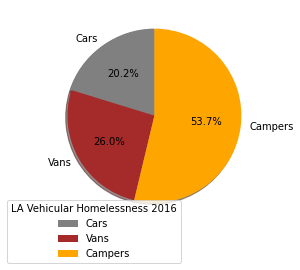

In [83]:
labels = ['Cars','Vans','Campers']
sizes = [car_total16,van_total16,camper_total16]
explode = (0,0,0.1)

fig1, rent = plt.subplots()
rent.pie(sizes, labels=labels, autopct='%1.1f%%',
        shadow=True, startangle=90, colors = ['gray','brown','orange'])
rent.legend(loc = 'lower left',bbox_to_anchor = (-0.2,-0.2),title = "LA Vehicular Homelessness 2016") 
plt.show()

Refer back to the midterm. What has changed? Camper- and van-based homelessness are slightly less common. Car-based homelessness is more common. Could this because enforcement has forced homelessness into less conspicuious forms? 

(Around this time, approaching midnight, I stepped out to smoke in the alley behind my apartment. As I did so, a man walked up to a Honda Civic that has been parked back there the past few weeks, climed into the back seat, and laid down. Presumably he is living out it.)

Note that overall vehicular homelessness has increased from 7,097 to 10,337.5, a startling 45.7% increase. 

### 2.3 The Changing Geography of Vehicular Homelessness

Let's now look into how vehicular homelessness changed spatially. I originally want to analyze this as percent change, but between 2016 and 2020, many tracts increased from zero, and you can't run percent change calculations on that base. Instead, I look at absolute changes.

In [81]:
master['totalCHANGE'] = (master.total2020 - master.total2016)
master['carsCHANGE'] = (master.cars2020 - master.cars2016)
master['vansCHANGE'] = (master.vans2020 - master.vans2016)
master['campersCHANGE'] = (master.campers2020 - master.campers2016)
master.sample(3)

,tract,cars2020,vans2020,campers2020,total2020,geometry,TotalPop,total_per_1000,cars_per_1000,vans_per_1000,...,vans_lag_diff,campers_lag_diff,cars2016,vans2016,campers2016,total2016,totalCHANGE,carsCHANGE,vansCHANGE,campersCHANGE
359,183103,3.024,7.096,8.525,18.645,"MULTIPOLYGON (((-13155312.961 4043911.461, -13...",4355.0,4.281286,0.694374,1.629392,...,-0.018047,1.238042,0.0,3.0,6.0,9.0,9.645,3.024,4.096,2.525
753,234800,1.396,1.682,3.192,6.270,"MULTIPOLYGON (((-13171066.004 4026363.440, -13...",3317.0,1.890262,0.420862,0.507085,...,-0.255207,-3.724224,0.0,2.0,2.0,4.0,2.270,1.396,-0.318,1.192
405,189600,0.000,0.000,0.000,0.000,"MULTIPOLYGON (((-13171986.617 4043630.994, -13...",3939.0,0.000000,0.000000,0.000000,...,-0.504703,-0.617032,0.0,7.0,0.0,7.0,-7.000,0.000,-7.000,0.000


Let's map vehicular homeless in both 2016 and 2020, both in total and by type. Just for fun, let's make a function and loop it.

In [118]:
map_me = ['cars2020','cars2016','vans2020','vans2016','campers2020','campers2016','total2020','total2016']

def map_maker(list):
    fig,ax = plt.subplots(1,1,figsize = (8,8))
    master.plot(ax=ax,
        column = master[list],
        cmap='RdYlGn_r', 
        scheme='user_defined',
        classification_kwds = {'bins':[0,2,5,10,500]}, #setting my own classification bins to make the maps comparable
        edgecolor='white', 
        linewidth=0,
        legend = True,
        alpha=0.75)
    ax.axis("off")
    ax.set_title(list)

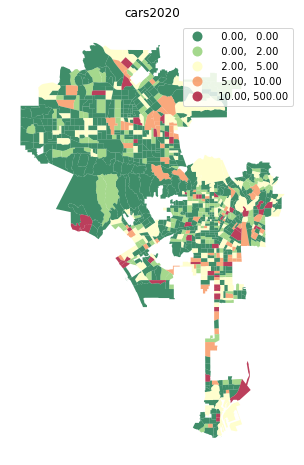

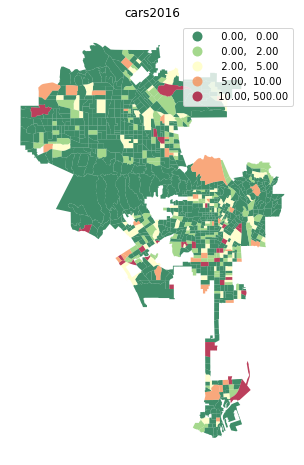

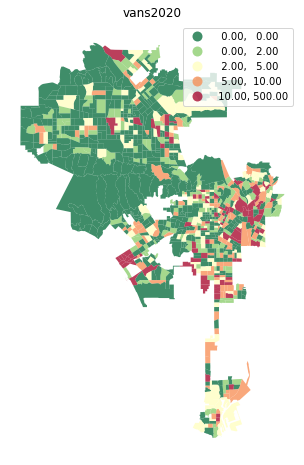

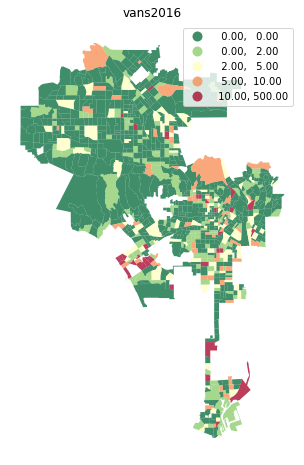

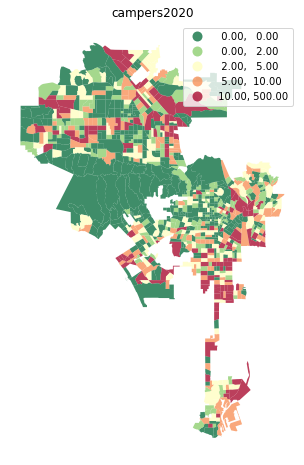

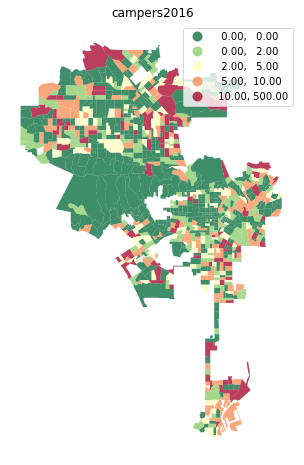

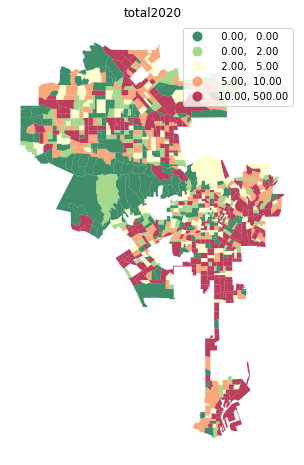

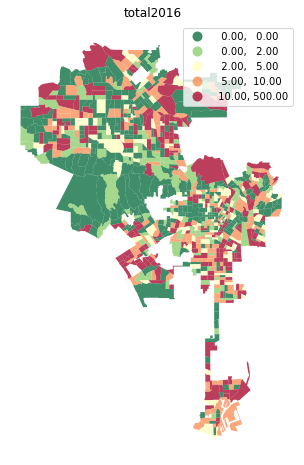

In [119]:
for column in map_me:
    map_maker(column)

These maps illustrate the extent to which (a) vehicular homelessness has increased and (b) grown more dispersed. Let's map absolute change onto Kepler.

In [126]:
from keplergl import KeplerGl

In [134]:
master['totalCHANGEpro'] = (master['totalCHANGE']**2)
master['carsCHANGEpro'] = (master['carsCHANGE']**2)
master['vansCHANGEpro'] = (master['vansCHANGE']**2)
master['campersCHANGEpro'] = (master['campersCHANGE']**3)

In [135]:
master_wm = master.to_crs(epsg=3857)
map = KeplerGl(height=600,width=800)
map.add_data(data=master_wm,name="Absolute Change in Vehicular Homelessness in LA, 2016 to 2020")
map

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


KeplerGl(data={'Absolute Change in Vehicular Homelessness in LA, 2016 to 2020': {'index': [0, 1, 2, 3, 4, 5, 6…

In [138]:
map.save_to_html(file_name = 'la_vehicular_homeless_change.html')

Map saved to la_vehicular_homeless_change.html!
